# Plot and explore the data

Make some plots and maps to see what the data look like.
For this, we'll use the combined dataset generated by [`merge.ipynb`](merge.ipynb).

In [1]:
from pathlib import Path
import matplotlib.pyplot as plt
import xarray as xr
import numpy as np
import pygmt
import pooch
import verde as vd
import boule as bl

In [2]:
plt.rc("figure", dpi=120)
pygmt.config(FONT="14p,Helvetica,black")

In [3]:
fig_dir = Path("..") / "figures"

## Load the data

Download the data from the GitHub release using [Pooch](https://www.fatiando.org/pooch/latest/) and then read the netCDF file.
The download only happens once and is then cached by Pooch for later use in any other project.

In [4]:
fname = pooch.retrieve(
    url="doi:10.6084/m9.figshare.13643837/australia-ground-gravity.nc",
    known_hash="md5:16c94a792003714efee2bdb4f3181d3a",
    downloader=pooch.DOIDownloader(progressbar=True)
)
data = xr.load_dataset(fname)
data

<xarray.Dataset>
Dimensions:            (point: 1789365)
Coordinates:
    longitude          (point) float64 138.6 138.6 138.8 ... 132.4 139.1 137.4
    latitude           (point) float64 -31.12 -31.13 -31.09 ... -25.5 -21.08
    height             (point) float32 515.111 470.832 ... 103.871 256.027
Dimensions without coordinates: point
Data variables:
    gravity            (point) float32 979314.8 979322.0 ... 978956.9 978629.1
    gravity_accuracy   (point) float32 0.19999999 0.19999999 ... 0.19999999
    height_error       (point) float32 10.06 10.06 10.06 ... 6.1600003 6.1600003
    reliability_index  (point) uint8 1 1 1 1 1 1 1 1 1 1 ... 4 4 4 4 4 4 4 4 4 4
    survey_id          (point) uint32 195951 195951 195951 ... 196111 196111
Attributes:
    Conventions:  CF-1.8
    title:        Compilation of gravity ground surveys for Australia
    institution:  Commonwealth of Australia (Geoscience Australia)
    crs:          WGS84
    source:       Compiled from the collection by Wynne, P. 2018. NetCDF Grou...
    uuid:         d6e3c3a8-5a20-4d8b-afca-e55f754e4ce1
    license:      Creative Commons Attribution 4.0 International Licence
    references:   https://doi.org/10.6084/m9.figshare.13643837
    history:      2021-08-24 (v2.0): Redownloaded and compiled the collection...

## Histograms

Look at the distribution of data values. This is helpful to make sure everything looks OK and we know the general trends in the data.

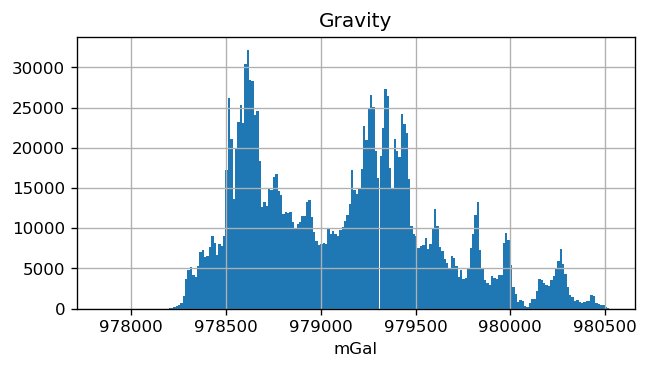

In [5]:
plt.figure(figsize=(6, 3))
plt.title("Gravity")
plt.hist(data.gravity.values, bins="auto")
plt.xlabel("mGal")
plt.grid()
plt.show()

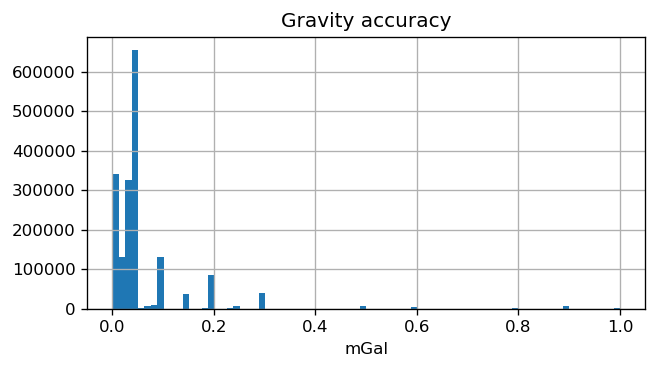

In [6]:
plt.figure(figsize=(6, 3))
plt.title("Gravity accuracy")
plt.hist(data.gravity_accuracy.values, bins=80)
plt.xlabel("mGal")
plt.grid()
plt.show()

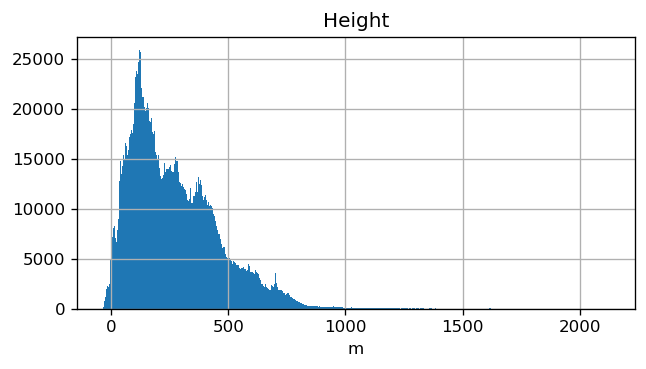

In [7]:
plt.figure(figsize=(6, 3))
plt.title("Height")
plt.hist(data.height.values, bins="auto")
plt.xlabel("m")
plt.grid()
plt.show()

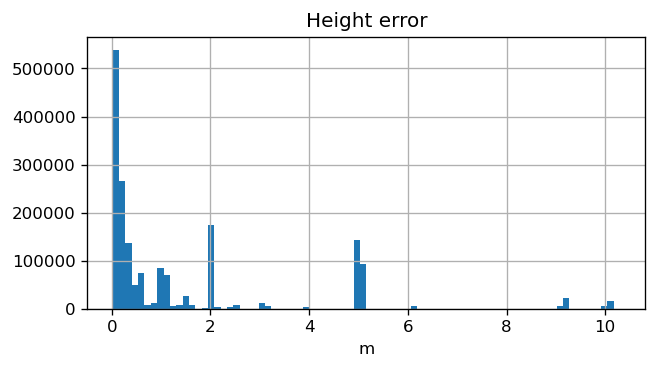

In [8]:
plt.figure(figsize=(6, 3))
plt.title("Height error")
plt.hist(data.height_error.values, bins=80)
plt.xlabel("m")
plt.grid()
plt.show()

Some points seem to be below 0m ellipsoid height. This could cause problems for normal gravity calculation (it would be inside the ellipsoid and normal gravity equations are mostly valid outside only).

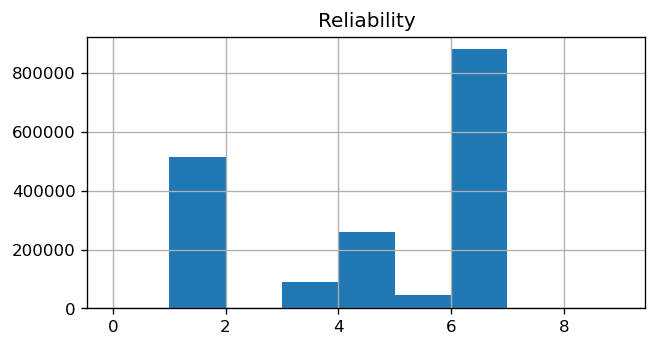

In [9]:
plt.figure(figsize=(6, 3))
plt.title("Reliability")
plt.hist(data.reliability_index.values, bins=data.reliability_index.attrs["flag_values"])
plt.grid()
plt.show()

Most points are either 1 (`insufficient_information_to_accurately_classify_but_still_regarded_as_reliable_data`) or 6 (`a_point_occupied_once_with_well_defined_position_and_elevation`) so this is good.

## Absolute gravity

Now plot the data points on maps so we can have a sense for the spatial distribution.

First, we'll downsample the data with block mean so that the plotting doesn't take too long.
We'll weight the mean by the data accuracy and return coordinates of the center of each block (instead of the mean coordinates).

In [10]:
blockmean = vd.BlockMean(spacing=0.1, center_coordinates=True, uncertainty=True)

(longitude, latitude), (gravity, height), _ = blockmean.filter(
    coordinates=(data.longitude.values, data.latitude.values),
    data=(data.gravity.values, data.height.values),
    weights=(1/data.gravity_accuracy.values**2, 1/data.height_error.values**2)
)

Let's see how much this reduced the data.

In [11]:
print(f"Downsampled: {gravity.size}")
print(f"Original:    {data.gravity.size}")

Downsampled: 67488
Original:    1789365


Now we can make a map of the reduced data in a reasonable amount of time.

In [12]:
region = [112, 155, -45, -7]

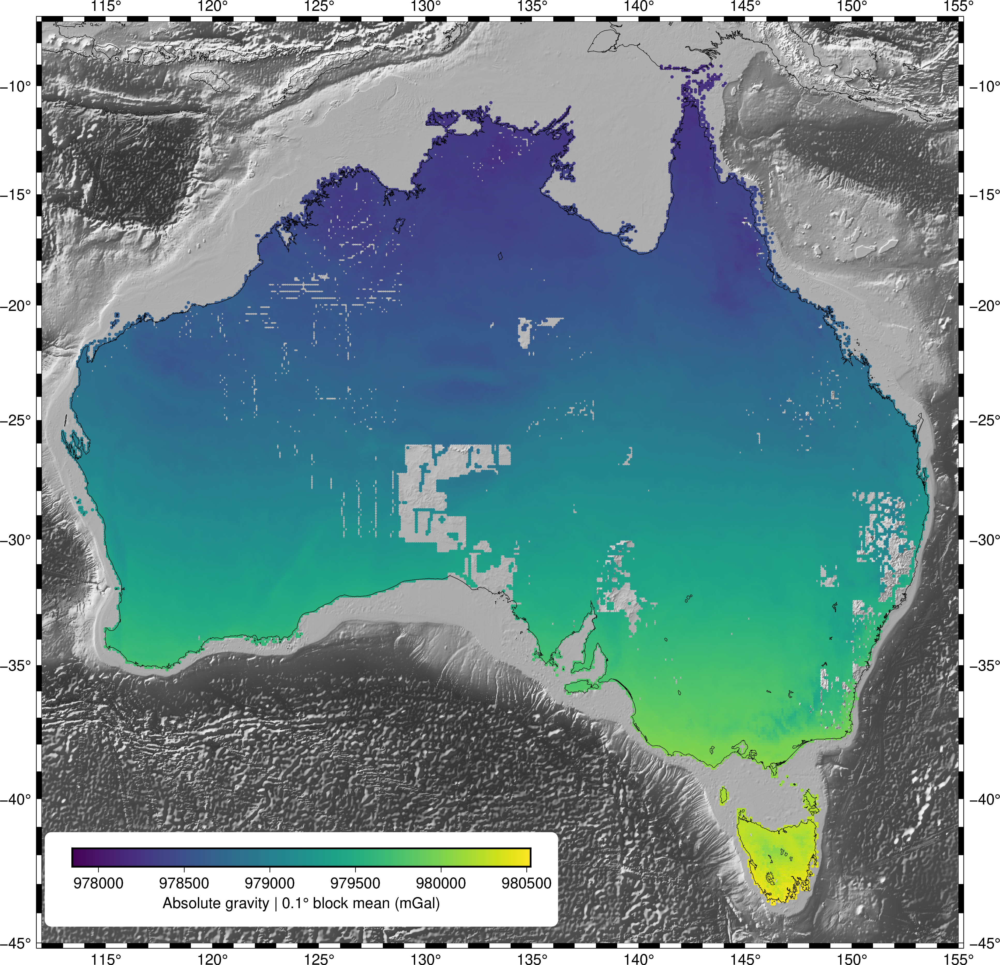

In [13]:
fig = pygmt.Figure()
fig.basemap(region=region, projection="M30c", frame="af")
fig.grdimage("@earth_relief_01m", cmap="gray", shading=True)
pygmt.makecpt(cmap="viridis", series=data.gravity.actual_range)
fig.plot(longitude, latitude, color=gravity, style="c0.1c", cmap=True)
fig.colorbar(
    box='+gwhite+c0.1c/0.5c+r',
    position="jBL+h+w15c+o1c/2.5c", 
    frame=f'x500+l"Absolute gravity | {blockmean.spacing}\\260 block mean (mGal)"'
)
fig.coast(shorelines=True)
fig.savefig(str(fig_dir / "australia-ground-gravity-absolute.png"), dpi=200)
fig.show(width=900)

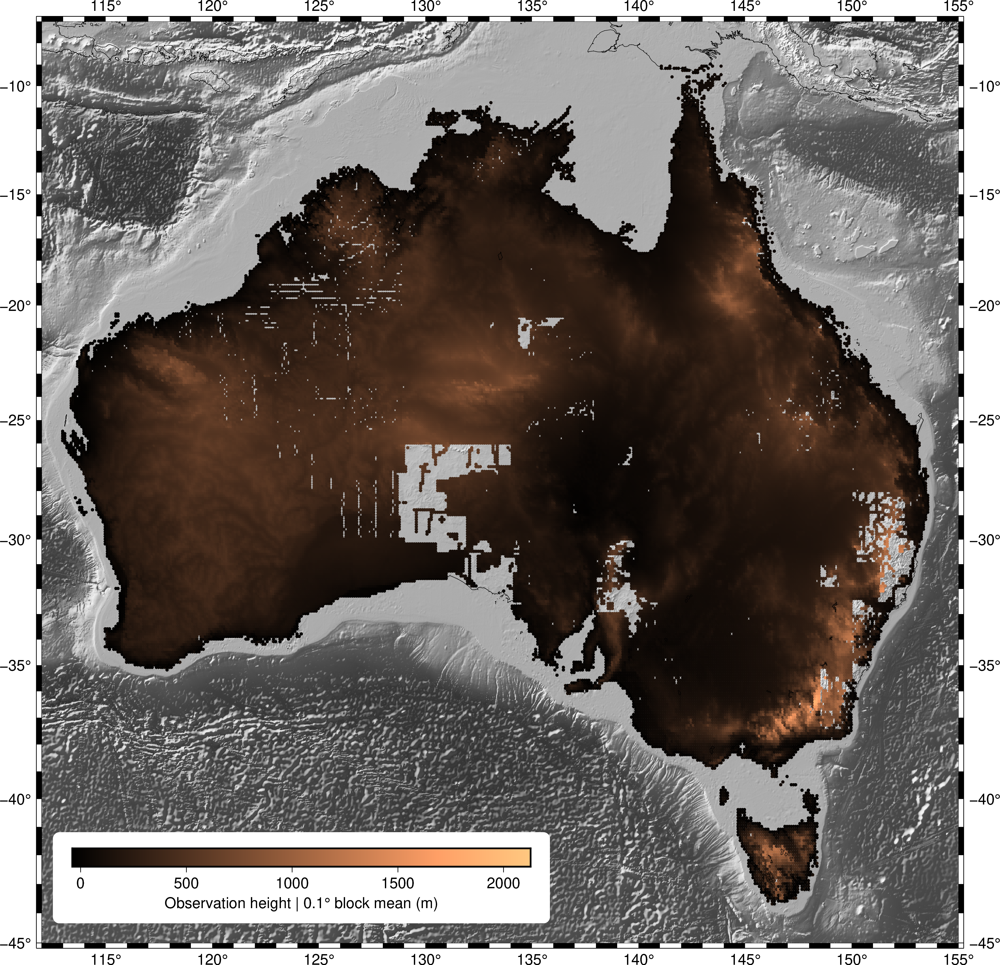

In [14]:
fig = pygmt.Figure()
fig.basemap(region=region, projection="M30c", frame="af")
fig.grdimage("@earth_relief_01m", cmap="gray", shading=True)
pygmt.makecpt(cmap="copper", series=data.height.actual_range)
fig.plot(longitude, latitude, color=height, style="c0.1c", cmap=True)
fig.colorbar(
    box='+gwhite+c0.1c/0.5c+r',
    position="jBL+h+w15c+o1c/2.5c", 
    frame=f'x500+l"Observation height | {blockmean.spacing}\\260 block mean (m)"'
)
fig.coast(shorelines=True)
fig.savefig(str(fig_dir / "australia-ground-gravity-height.png"), dpi=200)
fig.show(width=900)

### Gravity disturbance

Let's calculate gravity disturbances by subtracting the gravity of the WGS84 ellipsoid (using [Boule](https://github.com/fatiando/boule)).

In [15]:
normal_gravity = bl.WGS84.normal_gravity(data.latitude, data.height)
data["disturbance"] = data.gravity - normal_gravity

Now block reduce the disturbance as well and plot it.

In [16]:
(longitude, latitude), disturbance, _ = blockmean.filter(
    coordinates=(data.longitude.values, data.latitude.values),
    data=data.disturbance.values,
    weights=1/data.gravity_accuracy.values**2
)

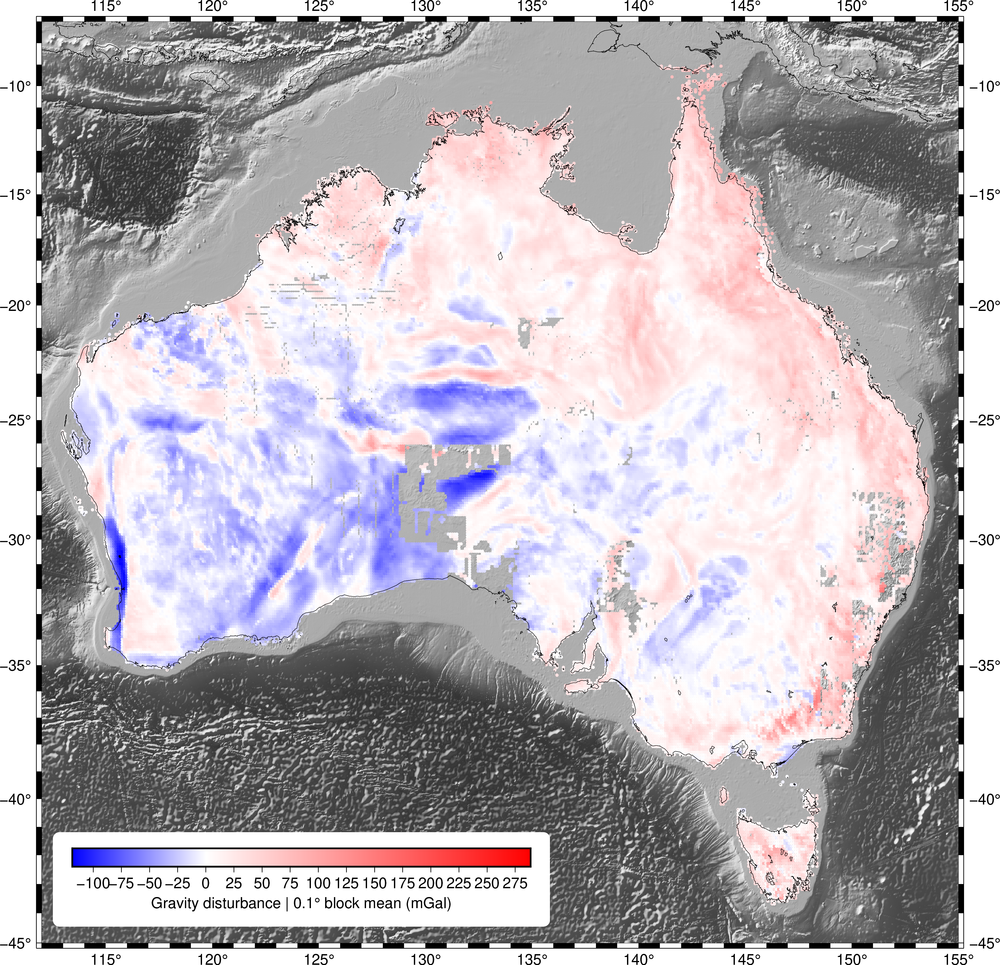

In [17]:
fig = pygmt.Figure()
fig.basemap(region=region, projection="M30c", frame="af")
fig.grdimage("@earth_relief_01m", cmap="gray", shading=True)
pygmt.makecpt(cmap="polar+h", series=[disturbance.min(), disturbance.max()])
fig.plot(longitude, latitude, color=disturbance, style="c0.1c", cmap=True)
fig.colorbar(
    box='+gwhite+c0.1c/0.5c+r',
    position="jBL+h+w15c+o1c/2.5c", 
    frame=f'x25+l"Gravity disturbance | {blockmean.spacing}\\260 block mean (mGal)"',
)
fig.coast(shorelines=True)
fig.savefig(str(fig_dir / "australia-ground-gravity-disturbance.png"), dpi=200)
fig.show(width=900)

## Point density

Plot the number of points per block to get a sense of the density of data.

In [18]:
blockcount = vd.BlockReduce(lambda x: x.size, spacing=0.1, center_coordinates=True)

(longitude, latitude), count = blockcount.filter(
    coordinates=(data.longitude.values, data.latitude.values),
    data=data.gravity.values,
)
count = count.astype(int)

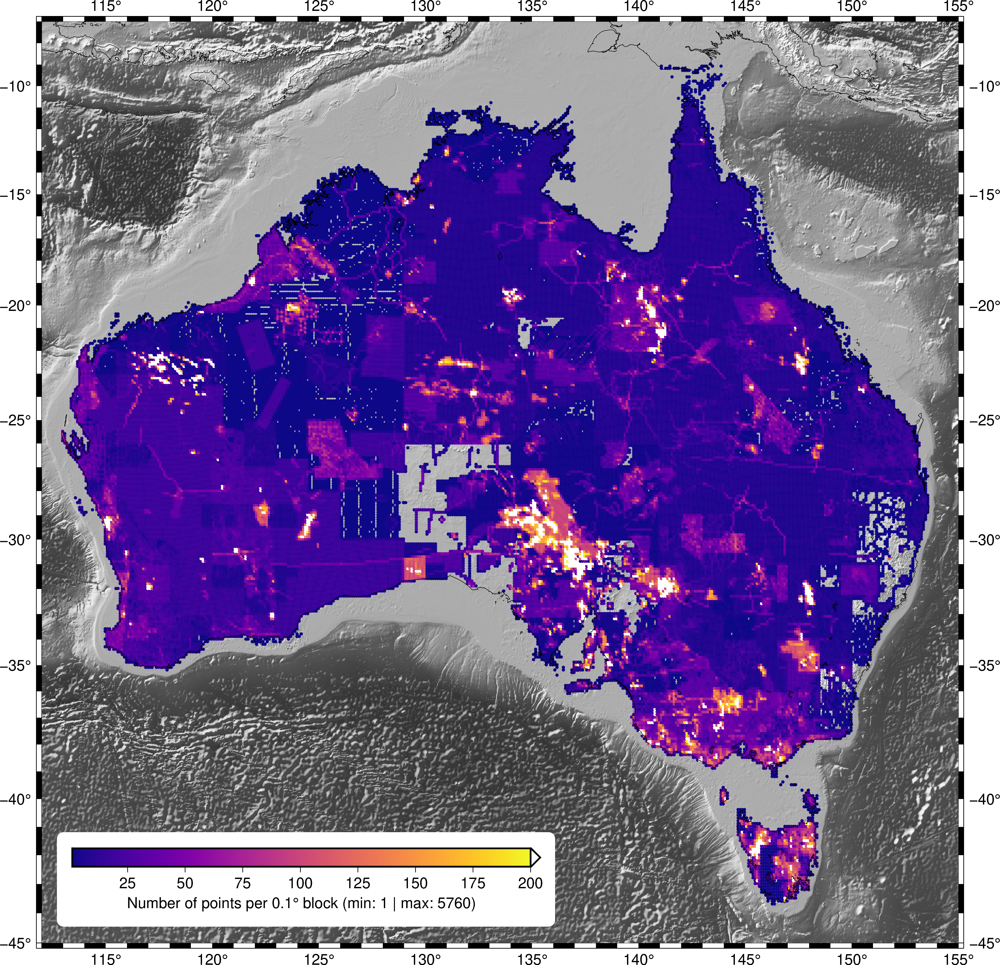

In [19]:
fig = pygmt.Figure()
fig.basemap(region=region, projection="M30c", frame="af")
fig.grdimage("@earth_relief_01m", cmap="gray", shading=True)
pygmt.makecpt(cmap="plasma", series=[count.min(), 200])
fig.plot(longitude, latitude, color=count, style="c0.1c", cmap=True)
fig.colorbar(
    box='+gwhite+c0.1c/0.5c+r',
    position="jBL+h+w15c+o1c/2.5c+ef", 
    frame=f'x25+l"Number of points per {blockmean.spacing}\\260 block (min: {count.min():d} | max: {count.max():d})"'
)
fig.coast(shorelines=True)
fig.savefig(str(fig_dir / "australia-ground-gravity-point-density.png"), dpi=200)
fig.show(width=900)